
#**Training Notebook - Object Detection**

#**Chen Shalev**





#**Import Libraries**


In [ ]:
import numpy as np
import pandas as pd
import cv2
from sklearn.utils import shuffle
from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
import warnings
import os
import json
warnings.simplefilter('ignore')

#**Load Dataset**

Self-Driving Cars from kaggle


In [ ]:

# Your Kaggle credentials
kaggle_credentials = {
    "username": "chenshalev",
    "key": "8eae8b826478eed985f1c72d9a9266b9"
}

# Create the Kaggle directory if it doesn't exist
kaggle_dir = os.path.expanduser("~/.kaggle")
os.makedirs(kaggle_dir, exist_ok=True)

# Write the Kaggle credentials to the kaggle.json file
kaggle_json_path = os.path.join(kaggle_dir, "kaggle.json")
with open(kaggle_json_path, "w") as kaggle_file:
    json.dump(kaggle_credentials, kaggle_file)

# Set the appropriate permissions
os.chmod(kaggle_json_path, 0o600)

print("Kaggle credentials set successfully!")

Kaggle credentials set successfully!


In [ ]:
!pip install -q kaggle

!kaggle datasets download -d alincijov/self-driving-cars

!unzip -q self-driving-cars.zip



Dataset URL: https://www.kaggle.com/datasets/alincijov/self-driving-cars
License(s): CC0-1.0
 98% 875M/892M [00:06<00:00, 124MB/s]
100% 892M/892M [00:06<00:00, 147MB/s]


In [ ]:
df = pd.read_csv('labels_train.csv')
df = shuffle(df)
df.head()
classes = df.class_id.unique()
print(classes)
labels = { 1:'car', 2:'truck', 3:'person', 4:'bicycle', 5:'traffic light'}


[1 5 2 3 4]


#**Example some labeled images**

In [ ]:
boxes = {}
images = {}

base_path = "images/"

for class_id in classes:
    first_row = df[df['class_id'] == class_id].iloc[0]

    images[class_id] = cv2.imread(base_path + first_row['frame'])
    boxes[class_id] = [first_row['xmin'],first_row['xmax'],first_row['ymin'],first_row['ymax']]

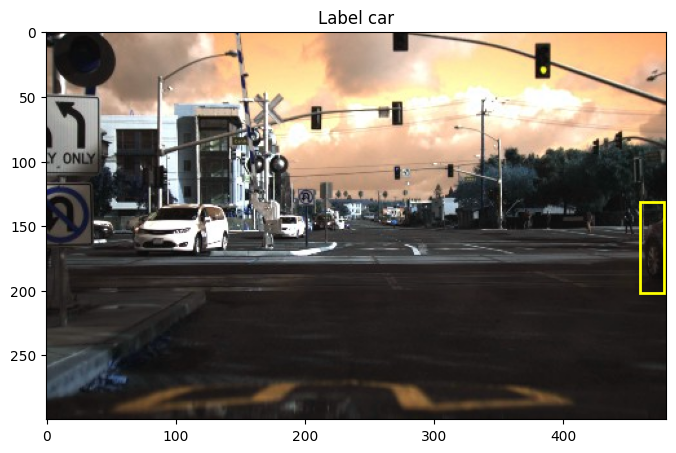

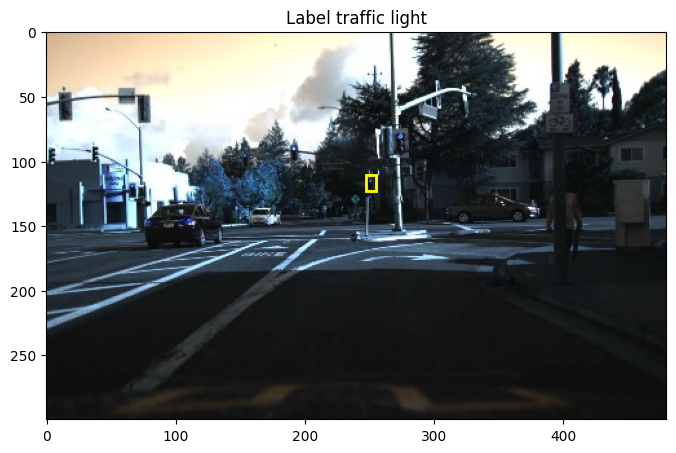

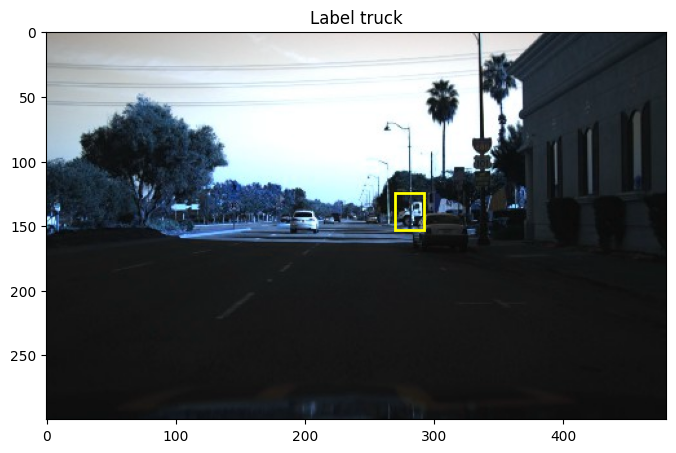

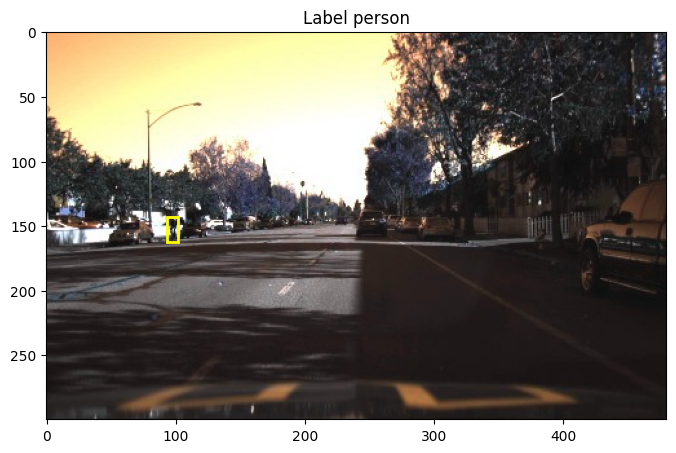

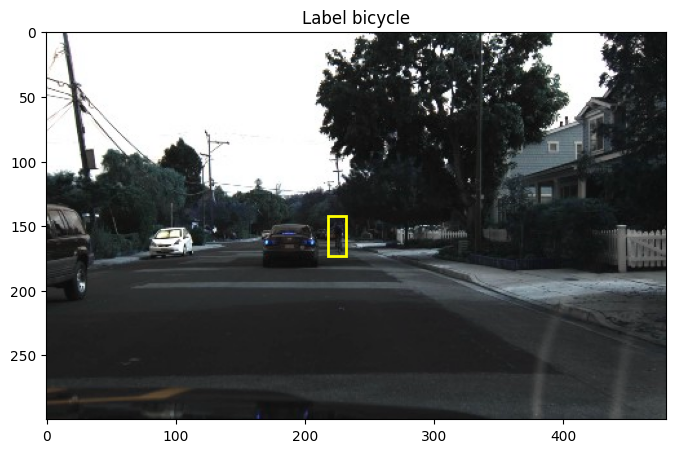

In [ ]:
for i in classes:

    xmin, xmax, ymin, ymax = boxes[i][0], boxes[i][1], boxes[i][2], boxes[i][3]

    plt.figure(figsize=(8, 10))
    plt.title("Label " + labels[i])
    plt.imshow(images[i])
    plt.gca().add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color='yellow', fill=False, linewidth=2))

    plt.show()

#**My Model**

 Ultralytics provides access to state-of-the-art YOLO models, which are known for their high performance in real-time object detection tasks

In [ ]:
!pip install ultralytics
from ultralytics import YOLO
import PIL
from PIL import Image
from IPython.display import display
import os
import pathlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 778.8/778.8 kB 4.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-m

In [ ]:
model = YOLO("yolov8m.pt")

100%|██████████| 49.7M/49.7M [00:00<00:00, 212MB/s]


#**Training 1- Image**

In [ ]:
results=model.predict(source="images/1478019956680248165.jpg",
              save=True, conf=0.2,iou=0.5)


image 1/1 /content/images/1478019956680248165.jpg: 416x640 1 car, 1 truck, 209.4ms
Speed: 23.6ms preprocess, 209.4ms inference, 3345.2ms postprocess per image at shape (1, 3, 416, 640)
Results saved to runs/detect/predict


In [ ]:
result = results[0]
box = result.boxes[0]
for result in results:
    boxes = result.boxes  # Boxes object for bbox outputs
    masks = result.masks  # Masks object for segmentation masks outputs
    probs = result.probs  # Class probabilities for classification outputs
    cords = box.xyxy[0].tolist()
class_id = box.cls[0].item()
conf = box.conf[0].item()
print("Object type:", class_id)
print("Coordinates:", cords)
print("Probability:", conf)
for box in result.boxes:
    class_id = result.names[box.cls[0].item()]
    cords = box.xyxy[0].tolist()
    cords = [round(x) for x in cords]
    conf = round(box.conf[0].item(), 2)
    print("Object type:", class_id)
    print("Coordinates:", cords)
    print("Probability:", conf)
    print("---")

Object type: 2.0
Coordinates: [124.69143676757812, 142.68826293945312, 148.7809295654297, 162.10049438476562]
Probability: 0.7161705493927002
Object type: car
Coordinates: [125, 143, 149, 162]
Probability: 0.72
---
Object type: truck
Coordinates: [141, 139, 157, 154]
Probability: 0.31
---


In [ ]:
results1 = model.predict("images/1478020211690815798.jpg",
              save=True, conf=0.2,iou=0.5)

Results = results1[0]


image 1/1 /content/images/1478020211690815798.jpg: 416x640 4 cars, 3 traffic lights, 27.1ms
Speed: 5.0ms preprocess, 27.1ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)
Results saved to runs/detect/predict


#**Display Image**

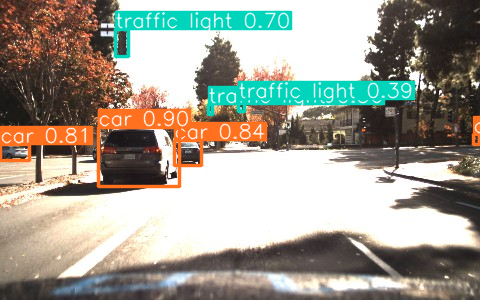

In [ ]:
# Plotting results
plot = results1[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

#**Training 2- Image**

PRO TIP 💡 Replace 'model=yolov5s.pt' with new 'model=yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



100%|██████████| 17.7M/17.7M [00:00<00:00, 139MB/s] 


Saving s.png to s.png

image 1/1 /content/s.png: 320x640 1 person, 13 cars, 2 trucks, 3 traffic lights, 92.0ms
Speed: 1.6ms preprocess, 92.0ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 640)
Results saved to runs/detect/predict2
Object type: person
Coordinates: [13, 260, 88, 442]
Probability: 0.88
---
Object type: car
Coordinates: [366, 278, 463, 339]
Probability: 0.86
---
Object type: traffic light
Coordinates: [341, 138, 357, 179]
Probability: 0.78
---
Object type: car
Coordinates: [480, 284, 522, 315]
Probability: 0.75
---
Object type: car
Coordinates: [439, 281, 490, 317]
Probability: 0.72
---
Object type: car
Coordinates: [1248, 316, 1280, 350]
Probability: 0.72
---
Object type: traffic light
Coordinates: [1121, 182, 1137, 218]
Probability: 0.7
---
Object type: traffic light
Coordinates: [706, 164, 720, 202]
Probability: 0.67
---
Object type: truck
Coordinates: [181, 242, 241, 314]
Probability: 0.65
---
Object type: car
Coordinates: [344, 281, 376, 304]
Probabilit

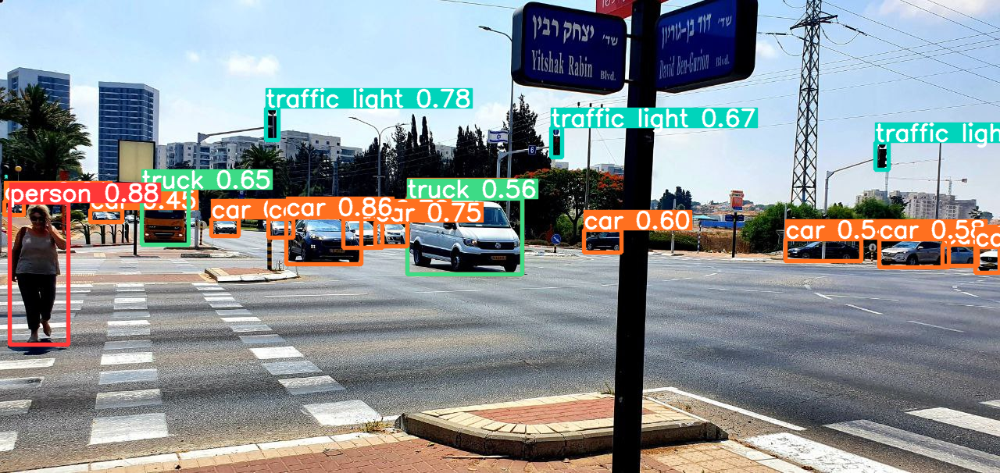

In [ ]:


# Function to upload file
def upload_file():
    from google.colab import files
    uploaded = files.upload()
    return list(uploaded.keys())[0]  # Return the first uploaded file path

# Initialize YOLO model
model = YOLO("yolov5s.pt")  # Assuming "yolov5s.pt" is the model file you want to use

# Get the file path from the user
new_image_path = upload_file()  # Use the upload_file() function to get the image path

# Predict on the new image
results = model.predict(source=new_image_path, save=True, conf=0.2, iou=0.5)

# Iterate through the results and print object detections
for result in results:
    for box in result.boxes:
        class_id = result.names[box.cls[0].item()]
        cords = box.xyxy[0].tolist()
        cords = [round(x) for x in cords]
        conf = round(box.conf[0].item(), 2)
        print("Object type:", class_id)
        print("Coordinates:", cords)
        print("Probability:", conf)
        print("---")

# Plot the results
plot = results[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))


#**Display Image**

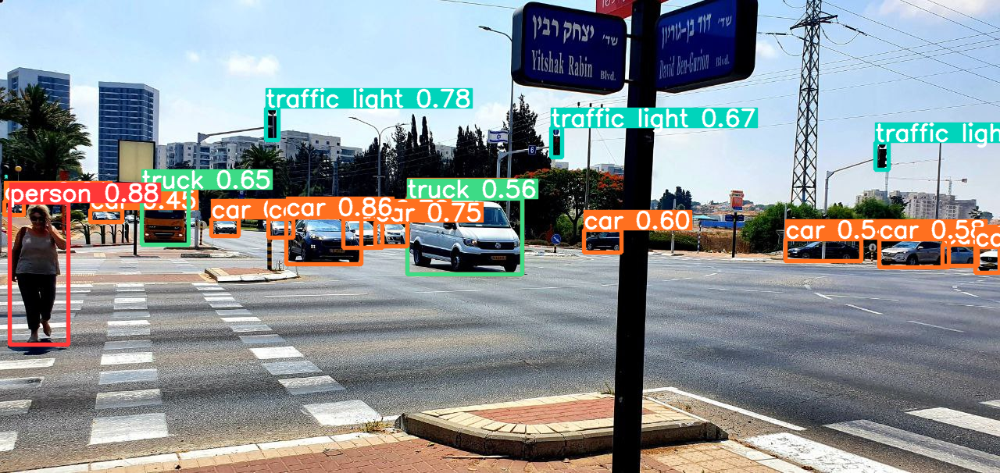

In [ ]:
# Plot the results
plot = results[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

#**Training 1- Video**

In [ ]:
# Function to upload file
def upload_file():
    from google.colab import files
    uploaded = files.upload()
    return list(uploaded.keys())[0]  # Return the first uploaded file path

# Initialize YOLO model
model = YOLO("yolov5s.pt")  # Assuming "yolov5s.pt" is the model file you want to use

# Get the file path from the user
new_video_path = upload_file()  # Use the upload_file() function to get the video path

import cv2
from google.colab.patches import cv2_imshow
from IPython.display import HTML
import io
import base64

# Define a color map for different classes
color_map = {
    0: (0, 255, 0),     # Green for class 0
    1: (255, 0, 0),     # Blue for class 1
    2: (0, 0, 255),     # Red for class 2
    3: (255, 255, 0),   # Cyan for class 3
    4: (255, 0, 255),   # Magenta for class 4
    # Add more colors for other classes if needed
}

# Open the video file
cap = cv2.VideoCapture(new_video_path)

# Check if the video opened successfully
if not cap.isOpened():
    print("Error: Could not open video.")
else:
    # Get the video properties
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)

    # Define the codec and create VideoWriter object
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter('output.mp4', fourcc, fps, (width, height))

    # Loop through the video frames
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Predict on the current frame
        results = model.predict(source=frame, save=False, conf=0.2, iou=0.5)

        # Draw detections on the frame
        for result in results:
            for box in result.boxes:
                class_id = box.cls[0].item()
                class_name = result.names[class_id]
                cords = box.xyxy[0].tolist()
                cords = [round(x) for x in cords]
                conf = round(box.conf[0].item(), 2)

                # Get the color for the class
                color = color_map.get(class_id, (0, 255, 255))  # Default color is yellow if class_id not in color_map

                # Draw the bounding box
                cv2.rectangle(frame, (cords[0], cords[1]), (cords[2], cords[3]), color, 2)
                # Put the label
                label = f"{class_name}: {conf}"
                cv2.putText(frame, label, (cords[0], cords[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

        # Write the frame with detections to the output video
        out.write(frame)

    # Release everything when the job is finished
    cap.release()
    out.release()
    cv2.destroyAllWindows()



PRO TIP 💡 Replace 'model=yolov5s.pt' with new 'model=yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



Saving video.mkv to video.mkv

0: 384x640 1 person, 13 cars, 1 truck, 2 traffic lights, 236.8ms
Speed: 4.0ms preprocess, 236.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 13 cars, 1 truck, 2 traffic lights, 20.5ms
Speed: 4.0ms preprocess, 20.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 14 cars, 3 traffic lights, 1 tv, 32.0ms
Speed: 3.8ms preprocess, 32.0ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 13 cars, 2 traffic lights, 16.7ms
Speed: 3.4ms preprocess, 16.7ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 12 cars, 3 traffic lights, 13.9ms
Speed: 3.0ms preprocess, 13.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 14 cars, 3 traffic lights, 22.1ms
Speed: 3.3ms preprocess, 22.1ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 14 c

#**Convert to MKV**






In [ ]:
# delete output.mkv
!rm output.mkv
# Step 1: Install FFmpeg

!apt-get install -y ffmpeg

# Step 2: Convert the MP4 to MKV
!ffmpeg -i output.mp4 output.mkv




Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 45 not upgraded.
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq -

#**Display video**

In [ ]:
# Step 3: Display the Video
from IPython.display import HTML
from base64 import b64encode

# Function to display the video
def display_video(file_path):
    video = open(file_path, "rb").read()
    video_encoded = b64encode(video).decode('ascii')
    return HTML(f'''
        <video width="1000" height="800" controls>
            <source src="data:video/mp4;base64,{video_encoded}" type="video/mp4">
        </video>
    ''')

# Display the MKV video
display_video('output.mkv')